In [1]:
import pandas as pd

# Load the dataset
file_path = "/Users/kdn_aisashwat/Desktop/supply_chain_resillience/classified_news.csv"
df = pd.read_csv(file_path)

# Display basic info and first few rows
df.info(), df.head()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65 entries, 0 to 64
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   title         65 non-null     object
 1   source        65 non-null     object
 2   published_at  65 non-null     object
 3   url           65 non-null     object
 4   full_text     56 non-null     object
 5   risk_type     65 non-null     object
dtypes: object(6)
memory usage: 3.2+ KB


(None,
                                                title               source  \
 0  WATCH: Teen paddleboarders rescued after 16-ho...             ABC News   
 1  FMCG, renewables, auto sectors to do well in f...             Livemint   
 2  Researchers make troubling discovery after res...  Yahoo Entertainment   
 3  LIVE NOW! Media Partnership – Competitiveness ...             EURACTIV   
 4  Comstock Announces 2025 Annual Meeting and Rec...        GlobeNewswire   
 
            published_at                                                url  \
 0  2025-03-19T10:31:13Z  https://abcnews.go.com/US/video/teen-paddleboa...   
 1  2025-03-19T10:31:03Z  https://www.livemint.com/money/personal-financ...   
 2  2025-03-19T10:30:49Z  https://www.yahoo.com/news/researchers-troubli...   
 3  2025-03-19T10:30:18Z  https://www.euractiv.com/section/economy-jobs/...   
 4  2025-03-19T10:30:00Z  https://www.globenewswire.com/news-release/202...   
 
                                            ful

In [2]:
# Convert 'published_at' to datetime format
df['published_at'] = pd.to_datetime(df['published_at'], errors='coerce')

# Check missing values in 'full_text'
missing_full_text = df['full_text'].isna().sum()

# Count unique risk categories
unique_risk_types = df['risk_type'].value_counts()

# Display results
missing_full_text, unique_risk_types


(np.int64(9),
 risk_type
 Geopolitical Risk     30
 Low Impact            25
 Cybersecurity Risk     5
 Climate Risk           5
 Name: count, dtype: int64)

In [3]:
# Fill missing 'full_text' with 'title' where applicable
df['full_text'].fillna(df['title'], inplace=True)

# Verify if missing values are handled
missing_full_text_after = df['full_text'].isna().sum()
missing_full_text_after


/var/folders/_m/k60bcms15c37y9zd6_5jgdy40000gn/T/ipykernel_44070/784601526.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['full_text'].fillna(df['title'], inplace=True)


np.int64(0)

In [5]:
from geotext import GeoText

# Function to extract locations using GeoText
def extract_locations_geo(text):
    places = GeoText(text)
    return list(set(places.cities + places.countries))  # Extract cities & countries

# Apply extraction to the dataset
df["extracted_locations"] = df["full_text"].apply(lambda x: extract_locations_geo(str(x)))

# Display some extracted locations
df[["title", "extracted_locations"]].head(10)


,title,extracted_locations
0,WATCH: Teen paddleboarders rescued after 16-ho...,[Florida]
1,"FMCG, renewables, auto sectors to do well in f...",[India]
2,Researchers make troubling discovery after res...,"[United Kingdom, Russia, China, Cleveland]"
3,LIVE NOW! Media Partnership – Competitiveness ...,[Summit]
4,Comstock Announces 2025 Annual Meeting and Rec...,"[United States, March]"
5,"The Best White Wines Under $10, According To T...",[]
6,6 breathtaking destinations to explore in the ...,[India]
7,Sports presenter Anita Jones says she was ‘gas...,[March]
8,WATCH: Teacher turns tragedy into good deeds w...,[]
9,Cities: Skylines 2 Update Celebrates 10th Anni...,"[San Francisco, Lakeland, Tampere, Normal]"


In [7]:
import networkx as nx
from geopy.distance import geodesic
from itertools import combinations

# Initialize a graph
G = nx.Graph()

# Extract unique locations from the dataset
unique_locations = set(loc for locations in df["extracted_locations"] for loc in locations)

# Add locations as nodes in the graph
for location in unique_locations:
    G.add_node(location)

# Function to estimate transport cost based on distance
def estimate_distance(loc1, loc2):
    try:
        return geodesic(loc1, loc2).km  # Distance in km
    except:
        return float("inf")  # If distance can't be calculated

# Create edges between locations (Assumption: Locations in the same news article are connected)
for locations in df["extracted_locations"]:
    for loc1, loc2 in combinations(locations, 2):  # Pairwise connections
        distance = estimate_distance(loc1, loc2)
        G.add_edge(loc1, loc2, weight=distance)

# Display basic graph info
print(nx.number_of_nodes(G))  # Number of locations (nodes)
print(nx.number_of_edges(G))  # Number of transport routes (edges)



145
730


In [10]:
import folium
from geopy.geocoders import Nominatim
import time

# Initialize geolocator
geolocator = Nominatim(user_agent="geo_locator")

# Dictionary to store lat/lon of locations
location_coords = {}

# Get lat/lon for each unique location
for location in unique_locations:
    try:
        loc = geolocator.geocode(location, timeout=10)
        if loc:
            location_coords[location] = (loc.latitude, loc.longitude)
        time.sleep(1)  # To avoid rate limits
    except:
        continue

# Create a Folium Map centered around an average location
map_center = list(location_coords.values())[0] if location_coords else [20.5937, 78.9629]  # Default: India
supply_chain_map = folium.Map(location=map_center, zoom_start=3)

# Add nodes (locations) to the map
for location, coords in location_coords.items():
    folium.Marker(coords, popup=location, icon=folium.Icon(color="blue")).add_to(supply_chain_map)

# Display the map
supply_chain_map


In [ ]:
#SATELLITE DATA

In [50]:
import pandas as pd
import networkx as nx
import geopy.distance

# Load dataset
file_path = "/Users/kdn_aisashwat/Desktop/supply_chain_resillience/updated_locations.csv"
df = pd.read_csv(file_path)

# Ensure required columns exist
df.columns = [col.strip() for col in df.columns]
required_columns = {"Date", "BBox", "Temperature (°C)", "Humidity (%)", "Precipitation (mm)", "Wind Speed (m/s)", "location"}
df = df[[col for col in df.columns if col in required_columns]]

# Handle missing locations using BBox
def extract_bbox_center(bbox):
    """Extract the center coordinates (latitude, longitude) from a bounding box string."""
    try:
        coords = [float(x) for x in bbox.strip("[]").split(",")]
        min_lon, min_lat, max_lon, max_lat = coords  # Correct ordering
        center_lat = (min_lat + max_lat) / 2
        center_lon = (min_lon + max_lon) / 2
        return (center_lat, center_lon)  # Latitude first, Longitude second
    except Exception as e:
        print(f"Error processing bbox {bbox}: {e}")
        return None


df["Coordinates"] = df.apply(lambda row: extract_bbox_center(row["BBox"]) if row["location"] == "Unknown Location" else None, axis=1)

# Fill missing coordinates for known locations
location_coords = {loc: extract_bbox_center(bbox) for loc, bbox in zip(df["location"], df["BBox"]) if loc != "Unknown Location"}
df["Coordinates"] = df.apply(lambda row: location_coords.get(row["location"], row["Coordinates"]), axis=1)

# Remove invalid coordinate values (Latitude must be in [-90, 90])
df = df.dropna(subset=["Coordinates"])
df["Latitude"] = df["Coordinates"].apply(lambda x: x[0] if x else None)
df["Longitude"] = df["Coordinates"].apply(lambda x: x[1] if x else None)

df = df[(df["Latitude"] >= -90) & (df["Latitude"] <= 90)]

# Create NetworkX Graph
G = nx.Graph()

# Add nodes (locations)
for index, row in df.iterrows():
    G.add_node(row["location"], coords=row["Coordinates"])

# Define distance threshold (500 km)
DISTANCE_THRESHOLD = 500

# Connect nodes based on distance threshold
locations = list(G.nodes(data=True))
for i, (loc1, data1) in enumerate(locations):
    for j, (loc2, data2) in enumerate(locations):
        if i < j and data1["coords"] and data2["coords"]:  # Avoid duplicate edges & ensure valid coordinates
            try:
                dist = geopy.distance.geodesic(data1["coords"], data2["coords"]).km
                if dist <= DISTANCE_THRESHOLD:
                    G.add_edge(loc1, loc2, weight=dist)
            except ValueError as e:
                print(f"Skipping invalid coordinates for {loc1} or {loc2}: {e}")

# Check graph summary
num_nodes, num_edges = G.number_of_nodes(), G.number_of_edges()
print(f"Nodes: {num_nodes}, Edges: {num_edges}")


Nodes: 211, Edges: 1279


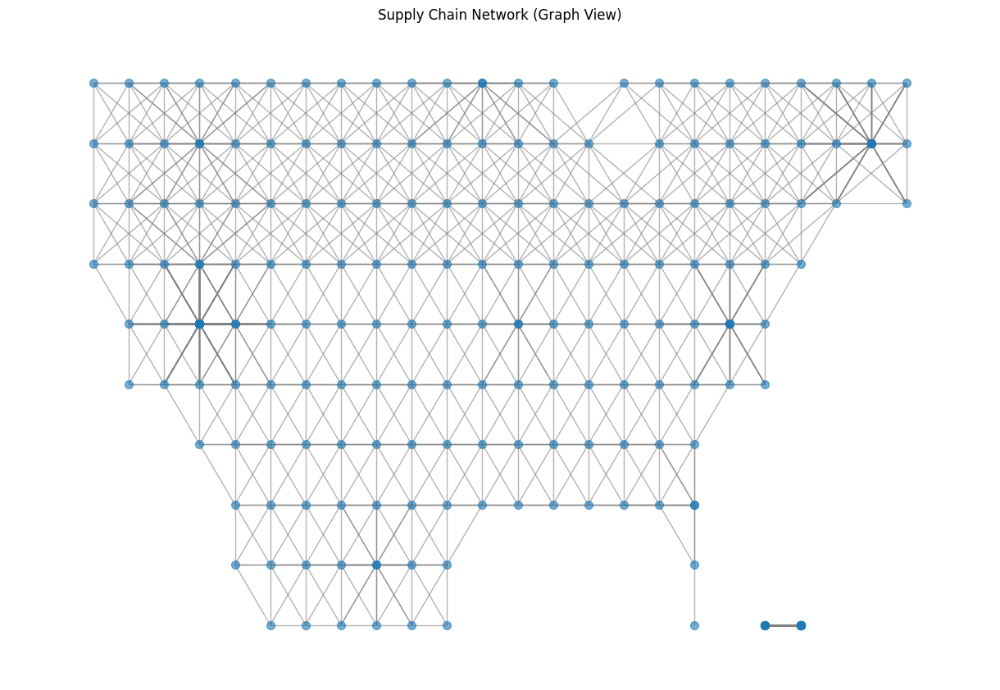

In [51]:
import matplotlib.pyplot as plt

# Set figure size
plt.figure(figsize=(12, 8))

# Get node positions from stored coordinates
pos = {loc: (coords[1], coords[0]) for loc, coords in nx.get_node_attributes(G, "coords").items()}  # (lon, lat) format

# Draw graph
nx.draw(G, pos, with_labels=False, node_size=50, edge_color="gray", alpha=0.6)

plt.title("Supply Chain Network (Graph View)")
plt.show()


In [52]:
import folium

# Initialize Folium map
map_center = list(nx.get_node_attributes(G, "coords").values())[0]  # First node as center
supply_chain_map = folium.Map(location=map_center, zoom_start=4)

# Add nodes (locations)
for location, coords in nx.get_node_attributes(G, "coords").items():
    folium.Marker(coords, popup=location, icon=folium.Icon(color="blue")).add_to(supply_chain_map)

# Add edges (connections)
for loc1, loc2 in G.edges():
    coords1, coords2 = G.nodes[loc1]["coords"], G.nodes[loc2]["coords"]
    folium.PolyLine([coords1, coords2], color="red", weight=1).add_to(supply_chain_map)

# Save the map as an HTML file (optional)
supply_chain_map.save("supply_chain_network.html")

# Show the map (only works in Jupyter Notebook)
supply_chain_map


In [53]:
# Define weight parameters (adjustable)
w1, w2, w3, w4 = 0.25, 0.25, 0.25, 0.25  # Equal weights

# Compute Risk Score for each location
def compute_risk_score(row):
    T, H, P, W = row["Temperature (°C)"], row["Humidity (%)"], row["Precipitation (mm)"], row["Wind Speed (m/s)"]
    temp_risk = abs(T - 5.668)
    humidity_risk = H / 100
    precipitation_risk = P / 91.68
    wind_risk = W / 18.37

    return (w1 * temp_risk) + (w2 * humidity_risk) + (w3 * precipitation_risk) + (w4 * wind_risk)

# Apply risk score calculation
df["Risk Score"] = df.apply(compute_risk_score, axis=1)

# Store risk score in the graph
for index, row in df.iterrows():
    G.nodes[row["location"]]["risk_score"] = row["Risk Score"]

# Check risk scores (sample)
df[["location", "Risk Score"]].head()
df.to_csv("updated_locations_with_risk.csv", index=False)



In [54]:
import folium
from folium.plugins import MarkerCluster

# Define risk level colors
def get_risk_color(score):
    if score <= 2.5:
        return 'green'  # Low Risk
    elif score <= 4.0:
        return 'orange'  # Medium Risk
    else:
        return 'red'  # High Risk

# Create a Folium map centered at an average location
avg_lat = sum(lat for lat, lon in df["Coordinates"]) / len(df)
avg_lon = sum(lon for lat, lon in df["Coordinates"]) / len(df)
map_risk = folium.Map(location=[avg_lat, avg_lon], zoom_start=5)

# Add markers using MarkerCluster
marker_cluster = MarkerCluster().add_to(map_risk)
for _, row in df.iterrows():
    folium.CircleMarker(
        location=row["Coordinates"],
        radius=5,
        color=get_risk_color(row["Risk Score"]),
        fill=True,
        fill_color=get_risk_color(row["Risk Score"]),
        fill_opacity=0.7,
        popup=f"Location: {row['location']}<br>Risk Score: {row['Risk Score']:.2f}"
    ).add_to(marker_cluster)

# Save the map to an HTML file
map_risk.save("risk_map.html")
print("✅ Risk map saved as risk_map.html")


✅ Risk map saved as risk_map.html


In [55]:
import folium
from IPython.display import display

# # Define the map center (adjust based on your data)
# map_center = [37.5, -95.5]  # Example: Approximate center of the USA

# # Create a Folium Map
# risk_map = folium.Map(location=map_center, zoom_start=5)

# # Add nodes (locations) to the map
# for _, row in df.iterrows():
#     folium.CircleMarker(
#         location=row["Coordinates"],
#         radius=5,
#         color=get_risk_color(row["Risk Score"]),
#         fill=True,
#         fill_color=get_risk_color(row["Risk Score"]),
#         fill_opacity=0.7,
#         popup=f"Location: {row['location']}<br>Risk Score: {row['Risk Score']:.2f}"
#     ).add_to(marker_cluster)
    
# Display the map
display(map_risk)


In [ ]:
import networkx as nx
import folium
from folium.plugins import MarkerCluster

from math import radians, sin, cos, sqrt, atan2

def haversine(coord1, coord2):
    """
    Calculate the great-circle distance between two coordinates using the Haversine formula.
    
    Parameters:
    coord1, coord2 : tuple of (latitude, longitude)
    
    Returns:
    Distance in kilometers
    """
    R = 6371  # Earth radius in km
    lat1, lon1 = map(radians, coord1)
    lat2, lon2 = map(radians, coord2)

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = sin(dlat / 2)**2 + cos(lat1) * cos(lat2) * sin(dlon / 2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))

    return R * c


def get_risk_color(score):
    if score <= 2.5:
        return 'green'  # Low Risk
    elif score <= 4.0:
        return 'orange'  # Medium Risk
    else:
        return 'red'  # High Risk

# Define weights
alpha = 1.0  # Distance weight
beta = 5.0  # Risk weight

# Create graph
G = nx.Graph()

# Add nodes
for idx, row in df.iterrows():
    G.add_node(idx, pos=row['Coordinates'], risk=row['Risk Score'])

# Add edges with adjusted weights
for idx1, row1 in df.iterrows():
    for idx2, row2 in df.iterrows():
        if idx1 != idx2:
            distance = haversine(row1['Coordinates'], row2['Coordinates'])
            risk_factor = row1['Risk Score'] + row2['Risk Score']
            adjusted_weight = alpha * distance + beta * risk_factor
            G.add_edge(idx1, idx2, weight=adjusted_weight)

# Compute shortest path (example: node 0 to node N)
source, target = 1000, len(df) - 1  # Modify as needed
shortest_path = nx.shortest_path(G, source=source, target=target, weight='weight')

astar_path = nx.astar_path(G, source=source, target=target, weight='weight')
print("A* Path:", astar_path)

# Visualize the path on Folium map
avg_lat = sum(lat for lat, lon in df['Coordinates']) / len(df)
avg_lon = sum(lon for lat, lon in df['Coordinates']) / len(df)
map_path = folium.Map(location=[avg_lat, avg_lon], zoom_start=5)
marker_cluster = MarkerCluster().add_to(map_path)

# Add nodes
for _, row in df.iterrows():
    folium.CircleMarker(
        location=row['Coordinates'],
        radius=5,
        color=get_risk_color(row['Risk Score']),
        fill=True,
        fill_color=get_risk_color(row['Risk Score']),
        fill_opacity=0.7,
        popup=f"Location: {row['location']}<br>Risk Score: {row['Risk Score']:.2f}"
    ).add_to(marker_cluster)

# Draw the safest path
path_coords = [df.iloc[node]['Coordinates'] for node in shortest_path]
folium.PolyLine(path_coords, color='blue', weight=3, opacity=0.7).add_to(map_path)

total_distance = sum(haversine(df.iloc[shortest_path[i]]['Coordinates'], 
                               df.iloc[shortest_path[i+1]]['Coordinates']) 
                     for i in range(len(shortest_path)-1))

total_risk = sum(df.iloc[node]['Risk Score'] for node in shortest_path)

print(f"Total Distance of Path: {total_distance:.2f} km")
print(f"Total Risk Score Along Path: {total_risk:.2f}")

print("Safest Path (Node Indices):", shortest_path)


display(map_path)
# Save and display
map_path.save("safest_path.html")
print("Safest path map saved as safest_path.html")


A* Path: [1000, 14639]
Total Distance of Path: 2929.68 km
Total Risk Score Along Path: 10.42
Safest Path (Node Indices): [1000, 14639]


✅ Safest path map saved as safest_path.html
